In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [6]:
!apt-get install -y graphviz libgraphviz-dev pkg-config
!pip install pygraphviz

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
pkg-config is already the newest version (0.29.2-1ubuntu3).
graphviz is already the newest version (2.42.2-6).
The following additional packages will be installed:
  libgail-common libgail18 libgtk2.0-0 libgtk2.0-bin libgtk2.0-common libgvc6-plugins-gtk
  librsvg2-common libxdot4
Suggested packages:
  gvfs
The following NEW packages will be installed:
  libgail-common libgail18 libgraphviz-dev libgtk2.0-0 libgtk2.0-bin libgtk2.0-common
  libgvc6-plugins-gtk librsvg2-common libxdot4
0 upgraded, 9 newly installed, 0 to remove and 15 not upgraded.
Need to get 2,433 kB of archives.
After this operation, 7,694 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/main amd64 libgtk2.0-common all 2.24.33-2ubuntu2 [125 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/main amd64 libgtk2.0-0 amd64 2.24.33-2ubuntu2 [2,037 kB]
Get:3 http://archive.ubuntu.com/ubuntu jamm

In [24]:
print(df['대분류'].unique())
print(df['중분류'].unique())
print(df['소분류'].unique())
print(df['세부분류'].unique())

['감정' '배경' '증상' '모호함' '일반대화' '내원이유' '원인' '상태' '치료이력' '부가설명' '자가치료']
['감정조절이상' '직장' '불안감' '심란' '걱정' '대화기피' '힘듦' '경제적문제' '곤혹감' '억울함' '자괴감' '연애'
 '부정적사고' '무기력' '의기소침' '신체이상' '피해망상' '고독감' '기억력저하' '성격' '식욕저하' '미안함'
 '자신감저하' '은둔' '과대망상' '무력감' '기억상실' '서운함' '만성피로' '사고' '취업' '가족' '없음' '시력저하'
 '의욕상실' '부모' '친구' '가슴떨림' '불면' '자존감저하' '문제' '답답' '죽음공포' '후회' '자녀' '슬픔'
 '반복사고' '남자친구' '임신' '알코올의존' '외로움' '불만' '불쾌감' '비관적' '양호' '공격적성향' '신경쓰임'
 '학업' '긴장' '집중력저하' '상담' '괴로움' '멍함' '눈물' '초조함' '좌절' '진로' '자살충동' '생각' '절망감'
 '폭식' '무서움' '악몽' '공허감' '짜증' '예민함' '남편' '대인기피' '생활' '두려움' '증상지속' '떨림'
 '소화불량' '메스꺼움' '모호함' '이인감' '기절' '두통' nan '불편감' '기분저하' '전연인' '우울감' '애완동물'
 '화' '응급실' '창피함' '공부' '공포' '피로' '불신' '인지기능저하' '학교' '아르바이트' '검사' '체중감소'
 '여자친구' '증상악화' '어지러움' '시댁' '무미건조' '속상함' '운동' '대학' '반복행동' '어린시절' '사업'
 '자살시도' '통제력상실' '성격변화' '기절예기' '건강문제' '기시감' '분노' '심리조절' '병원내원' '충분한휴식'
 '죄책감' '대인관계' '자각' '허무함' '저림현상' '귀국' '살인욕구' '타인' '결혼' '가슴답답' '통증' '과수면'
 '음주' '즐거움' '치료' '배신감' '건강염려' '환각' '이사' '미움' '성욕상승' '종교' '증상감소' '컨디션저조'
 '호흡곤

In [32]:
import pandas as pd

# CSV 파일 불러오기
file_path = '/content/drive/MyDrive/fill_counselor - fill_counselor.csv'
df = pd.read_csv(file_path, encoding='cp949')

# 1. 불필요한 컬럼 삭제
df = df.drop(columns=['상담 목표', '우울 수준', '불안 수준', 'input', 'output'])

# 2. '분류' 컬럼 추가 및 값 할당
df.insert(1, '분류', '분류')

# 3. 새로운 파일로 저장
new_file_path = 'visualization.csv'
df.to_csv(new_file_path, index=False)

print(f"작업이 완료되었습니다. 새로운 파일이 {new_file_path}에 저장되었습니다.")

작업이 완료되었습니다. 새로운 파일이 visualization.csv에 저장되었습니다.


In [56]:
csv_path = '/content/visualization.csv'

df = pd.read_csv(csv_path, encoding = 'utf-8')
print(df.head())

   Unnamed: 0  분류 대분류     중분류   소분류 세부분류  \
0           0  분류  감정  감정조절이상   NaN  NaN   
1           1  분류  배경      직장  스트레스  NaN   
2           2  분류  감정     불안감   NaN  NaN   
3           3  분류  감정      심란   NaN  NaN   
4           4  분류  감정      걱정    불면  NaN   

                                         Unnamed: 10  
0                                                NaN  
1  내담자님의 말씀을 듣고 보니, 일과 동료들과의 갈등으로 인한 스트레스가 크게 느껴지...  
2                                                NaN  
3                                                NaN  
4                                                NaN  


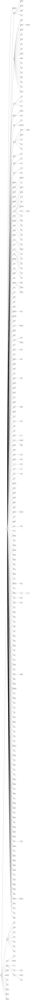

In [90]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import pygraphviz
from IPython.display import Image

csv_path = '/content/visualization.csv'
df = pd.read_csv(csv_path, encoding = 'utf-8')

G = nx.DiGraph()

for index, row in df.iterrows():
    if pd.notna(row['대분류']):
        G.add_edge(row['분류'], row['대분류'])
    if pd.notna(row['중분류']):
        G.add_edge(row['대분류'], row['중분류'])
    if pd.notna(row['소분류']):
        G.add_edge(row['중분류'], row['소분류'])
    if pd.notna(row['세부분류']):
        G.add_edge(row['소분류'], row['세부분류'])

dot = pygraphviz.AGraph(strict=True, directed=True)
dot.graph_attr['rankdir'] = 'LR'
dot.graph_attr['fontname'] = 'Arial Unicode MS'
dot.graph_attr['nodesep'] = 1
dot.graph_attr['ranksep'] = 1

root_node = df['분류'].dropna().iloc[0]
tree = nx.bfs_tree(G, root_node)

for edge in tree.edges():
    dot.add_node(edge[0], shape='box', fontname='Arial Unicode MS')
    dot.add_node(edge[1], shape='box', fontname='Arial Unicode MS')
    dot.add_edge(edge[0], edge[1])

pos = nx.spring_layout(tree, k=0.01)
output_file_path = '/content/drive/MyDrive/tidy_tree_updated.png'
dot.draw(output_file_path, format='png', prog='dot')
Image(output_file_path)

In [43]:
import pandas as pd
import networkx as nx
import pygraphviz
from IPython.display import Image

# CSV 파일 불러오기
csv_path = '/content/visualization.csv'
df = pd.read_csv(csv_path, encoding='utf-8')

# '분류' 열 추가 (임의로 설정)
df['분류'] = '상담'

# 그래프 객체 생성
G = nx.DiGraph()

# 각 로우를 순회하면서 엣지 추가
for index, row in df.iterrows():
    if pd.notna(row['대분류']):
        G.add_edge(row['분류'], row['대분류'])
    if pd.notna(row['중분류']):
        G.add_edge(row['대분류'], row['중분류'])
    if pd.notna(row['소분류']):
        G.add_edge(row['중분류'], row['소분류'])
    if pd.notna(row['세부분류']):
        G.add_edge(row['소분류'], row['세부분류'])

# 그래프 시각화를 위한 Graphviz 그래프 생성
dot = pygraphviz.AGraph(strict=True, directed=True)
dot.graph_attr['layout'] = 'circo'  # 원형 트리 설정

# '분류'를 기준으로 트리 구조 생성
root_node = df['분류'].dropna().iloc[0]  # '분류' 열에서 첫 번째로 나타난 값을 루트 노드로 선택
tree = nx.bfs_tree(G, root_node)

# 트리의 엣지를 추가하고 그래프를 시각화
for edge in tree.edges():
    dot.add_node(edge[0], shape='box', fontname='Arial Unicode MS')  # 폰트 설정 추가
    dot.add_node(edge[1], shape='box', fontname='Arial Unicode MS')
    dot.add_edge(edge[0], edge[1])

# 그래프 시각화
output_file_path = '/content/drive/MyDrive/tidy_tree_circle'
dot.layout(prog='dot')
dot.draw(f'{output_file_path}.png')

# 생성된 이미지 파일을 Colab에서 표시
Image(f'{output_file_path}.png')

In [91]:
!pip install plotly

In [92]:
import pandas as pd
import networkx as nx
import pygraphviz
import plotly.express as px

csv_path = '/content/visualization.csv'
df = pd.read_csv(csv_path, encoding='utf-8')

G = nx.DiGraph()

for index, row in df.iterrows():
    if pd.notna(row['대분류']):
        G.add_edge(row['분류'], row['대분류'])
    if pd.notna(row['중분류']):
        G.add_edge(row['대분류'], row['중분류'])
    if pd.notna(row['소분류']):
        G.add_edge(row['중분류'], row['소분류'])
    if pd.notna(row['세부분류']):
        G.add_edge(row['소분류'], row['세부분류'])

root_node = df['분류'].dropna().iloc[0]
tree = nx.bfs_tree(G, root_node)

# Create a hierarchy dataframe for treemap
treemap_df = pd.DataFrame(tree.edges(), columns=['parent', 'child'])

# Use plotly express to create a treemap
fig = px.treemap(treemap_df, path=['parent', 'child'], title='Treemap Visualization')
fig.update_layout(margin=dict(l=0, r=0, b=0, t=40))

# Show the treemap
fig.show()

In [112]:
import pandas as pd
import networkx as nx
import plotly.graph_objects as go

csv_path = '/content/visualization.csv'
df = pd.read_csv(csv_path, encoding='utf-8')

# 전체 범위의 노드별 로우 개수 저장
node_counts = df['분류'].append(df['대분류']).append(df['중분류']).append(df['소분류']).append(df['세부분류']).value_counts()

# 전체 범위의 그래프 생성
G = nx.DiGraph()
for index, row in df.iterrows():
    if pd.notna(row['대분류']):
        G.add_edge(row['분류'], row['대분류'], count=node_counts[row['대분류']])
    if pd.notna(row['중분류']):
        G.add_edge(row['대분류'], row['중분류'], count=node_counts[row['중분류']])
    if pd.notna(row['소분류']):
        G.add_edge(row['중분류'], row['소분류'], count=node_counts[row['소분류']])
    if pd.notna(row['세부분류']):
        G.add_edge(row['소분류'], row['세부분류'], count=node_counts[row['세부분류']])

root_node = df['분류'].dropna().iloc[0]
tree = nx.bfs_tree(G, root_node)

# 전체 범위의 트리맵 생성
treemap_df = pd.DataFrame(tree.edges(), columns=['parent', 'child'])
treemap_df['count'] = treemap_df['child'].map(node_counts)

# 트리맵 생성
fig = go.Figure(go.Treemap(labels=treemap_df['child'], parents=treemap_df['parent'], values=treemap_df['count']))
fig.update_traces(marker=dict(colors=['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']))

# 전체 레이아웃 설정
fig.update_layout(margin=dict(l=0, r=0, b=0, t=40), title_text='전체 트리맵')

# 트리맵 표시
fig.show()

<ipython-input-112-523271eea879>:9: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-112-523271eea879>:9: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-112-523271eea879>:9: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



In [93]:
import pandas as pd
import networkx as nx
import pygraphviz
import plotly.express as px

csv_path = '/content/visualization.csv'
df = pd.read_csv(csv_path, encoding='utf-8')

G = nx.DiGraph()

# 노드별로 로우 개수 저장
node_counts = df['분류'].append(df['대분류']).append(df['중분류']).append(df['소분류']).append(df['세부분류']).value_counts()

for index, row in df.iterrows():
    if pd.notna(row['대분류']):
        G.add_edge(row['분류'], row['대분류'], count=node_counts[row['대분류']])
    if pd.notna(row['중분류']):
        G.add_edge(row['대분류'], row['중분류'], count=node_counts[row['중분류']])
    if pd.notna(row['소분류']):
        G.add_edge(row['중분류'], row['소분류'], count=node_counts[row['소분류']])
    if pd.notna(row['세부분류']):
        G.add_edge(row['소분류'], row['세부분류'], count=node_counts[row['세부분류']])

root_node = df['분류'].dropna().iloc[0]
tree = nx.bfs_tree(G, root_node)

# 트리맵을 위한 계층 구조 데이터프레임 생성
treemap_df = pd.DataFrame(tree.edges(), columns=['parent', 'child'])
treemap_df['count'] = treemap_df['child'].map(node_counts)

# plotly express를 사용하여 트리맵 생성
fig = px.treemap(treemap_df, path=['parent', 'child'], values='count', title='트리맵 시각화')
fig.update_layout(margin=dict(l=0, r=0, b=0, t=40))

# 트리맵 표시
fig.show()

<ipython-input-93-6a8cac0593d9>:12: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-93-6a8cac0593d9>:12: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-93-6a8cac0593d9>:12: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



In [95]:
import pandas as pd
import networkx as nx
import pygraphviz
import plotly.express as px

csv_path = '/content/visualization.csv'
df = pd.read_csv(csv_path, encoding='utf-8')

# 1번부터 2100번까지와 2101번부터 끝까지의 로우를 각각 추출
subset_1_df = df.loc[(df.index >= 0) & (df.index < 2100)]
subset_2_df = df.loc[df.index >= 2100]

# 각 범위에 따른 노드별 로우 개수 저장
node_counts_1 = subset_1_df['분류'].append(subset_1_df['대분류']).append(subset_1_df['중분류']).append(subset_1_df['소분류']).append(subset_1_df['세부분류']).value_counts()
node_counts_2 = subset_2_df['분류'].append(subset_2_df['대분류']).append(subset_2_df['중분류']).append(subset_2_df['소분류']).append(subset_2_df['세부분류']).value_counts()

# 범위 1: 1번부터 2100번까지
G_1 = nx.DiGraph()
for index, row in subset_1_df.iterrows():
    if pd.notna(row['대분류']):
        G_1.add_edge(row['분류'], row['대분류'], count=node_counts_1[row['대분류']])
    if pd.notna(row['중분류']):
        G_1.add_edge(row['대분류'], row['중분류'], count=node_counts_1[row['중분류']])
    if pd.notna(row['소분류']):
        G_1.add_edge(row['중분류'], row['소분류'], count=node_counts_1[row['소분류']])
    if pd.notna(row['세부분류']):
        G_1.add_edge(row['소분류'], row['세부분류'], count=node_counts_1[row['세부분류']])

root_node_1 = subset_1_df['분류'].dropna().iloc[0]
tree_1 = nx.bfs_tree(G_1, root_node_1)

# 범위 2: 2101번부터 끝까지
G_2 = nx.DiGraph()
for index, row in subset_2_df.iterrows():
    if pd.notna(row['대분류']):
        G_2.add_edge(row['분류'], row['대분류'], count=node_counts_2[row['대분류']])
    if pd.notna(row['중분류']):
        G_2.add_edge(row['대분류'], row['중분류'], count=node_counts_2[row['중분류']])
    if pd.notna(row['소분류']):
        G_2.add_edge(row['중분류'], row['소분류'], count=node_counts_2[row['소분류']])
    if pd.notna(row['세부분류']):
        G_2.add_edge(row['소분류'], row['세부분류'], count=node_counts_2[row['세부분류']])

root_node_2 = subset_2_df['분류'].dropna().iloc[0]
tree_2 = nx.bfs_tree(G_2, root_node_2)

# 범위 1의 트리맵 생성
treemap_df_1 = pd.DataFrame(tree_1.edges(), columns=['parent', 'child'])
treemap_df_1['count'] = treemap_df_1['child'].map(node_counts_1)
fig_1 = px.treemap(treemap_df_1, path=['parent', 'child'], values='count', title='트리맵 시각화 (Subset 1: 1번부터 2100번까지)')
fig_1.update_layout(margin=dict(l=0, r=0, b=0, t=40))

# 범위 2의 트리맵 생성
treemap_df_2 = pd.DataFrame(tree_2.edges(), columns=['parent', 'child'])
treemap_df_2['count'] = treemap_df_2['child'].map(node_counts_2)
fig_2 = px.treemap(treemap_df_2, path=['parent', 'child'], values='count', title='트리맵 시각화 (Subset 2: 2101번부터 끝까지)')
fig_2.update_layout(margin=dict(l=0, r=0, b=0, t=40))

# 트리맵 표시
fig_1.show()
fig_2.show()

<ipython-input-95-56b9e52740b6>:14: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-95-56b9e52740b6>:14: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-95-56b9e52740b6>:14: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-95-56b9e52740b6>:14: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-95-56b9e52740b6>:15: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-95-56b9e52740b6>:15: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future versi